In [67]:
from astropy.io import fits
from astropy.table import Table
from astropy import wcs

import bz2
import scipy.ndimage as ndimage
import numpy as np
from glob import glob

import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
%matplotlib inline


In [6]:
def make_FITS_filename(RUN, CAMCOL, FIELD, FILTER):
    return "frame-{0}-{1:06d}-{2}-{3:04d}.fits.bz2".format(FILTER, RUN, CAMCOL, FIELD)

In [4]:
data = Table.read("data/clumpy_coadd_final75_gzh_dr12ancillary.fits")

/home/oxymoronic/Software/miniconda2/envs/data-env/lib/python2.7/site-packages/matplotlib/axes/_base.py:3025: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))


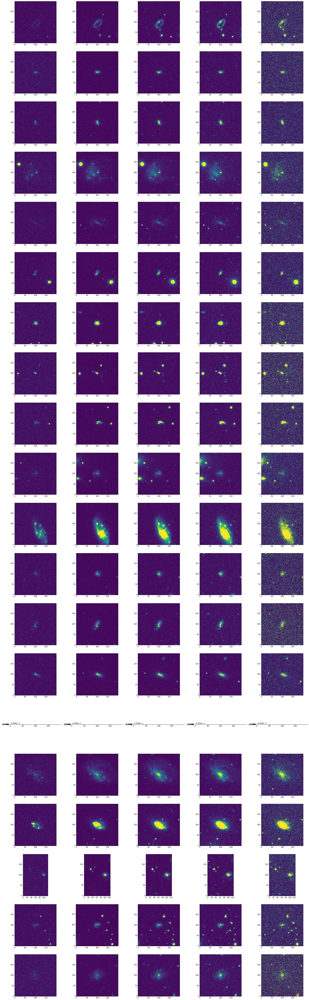

In [69]:
f = plt.figure(figsize=(30,100))
gs = gridspec.GridSpec(20,5)

for j, gal in enumerate(data[:20]):
    
    for i, band in enumerate(['u','g','r','i','z']):
        
        filename = make_FITS_filename(gal['run'], gal['DR12_camcol'], gal['DR12_field'], band)
        decompressed = bz2.BZ2File("data/imaging_final45/{}".format(filename))
        hdulist = fits.open(decompressed)
        img = hdulist[0].data
    
        w = wcs.WCS(hdulist[0].header)
        pix = w.wcs_world2pix(gal['ra'], gal['dec'],1)
        x, y=int(pix[1]), int(pix[0])
    
    
        ax = plt.subplot(gs[j,i])
        ax.imshow(img[x-100:x+100,y-100:y+100],origin='lower',cmap='viridis',vmin=-0.01, vmax=.5)
    
        hdulist.close()

In [148]:
def makecutout(hdulist, ra, dec, gal_size=None, pixel_scale=0.396, fixed_size=None):
    # gal_size is assumed to be given in arcsec
    # must be converted to pixels
    
    img = hdulist[0].data
    hdr = hdulist[0].header
    
    w = wcs.WCS(hdulist[0].header)
    pix = w.wcs_world2pix(ra, dec,1)
    row, col = int(pix[1]), int(pix[0])
        
    if fixed_size:
        extents = [int(row-fixed_size), int(row+fixed_size), 
                   int(col-fixed_size), int(col+fixed_size)]
        
    else:          
        # Radius in pixels
        rad = gal_size/pixel_scale

        #size = 3*radius
        extents = [int(row-3*rad), int(row+3*rad), int(col-3*rad), int(col+3*rad)] 

    
    # If subject is on the edge of image, notify 
    if (extents[1] > hdr['NAXIS2']) or (extents[3] > hdr['NAXIS1']) or \
        all(i > 0 for i in extents)==False:
        print "Cannot create subject stamp -- too close to image edge!"
        return 
    
    else:
        cutout = img[extents[0]:extents[1], extents[2]:extents[3]]

        print "Successfully created subject stamp."
        # convert the array into a FITS image
        return fits.ImageHDU(data=cutout, header=hdr)

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


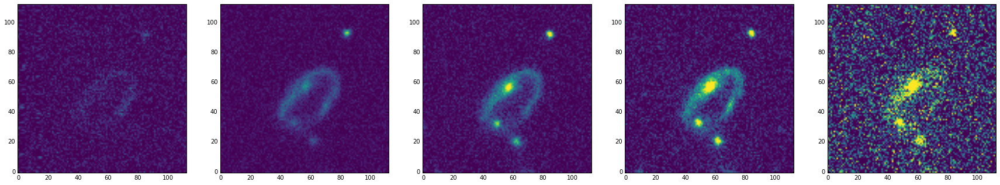

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


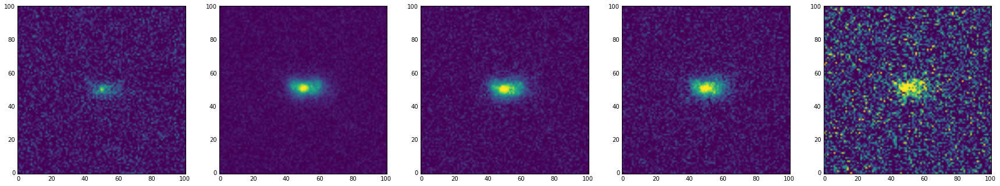

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


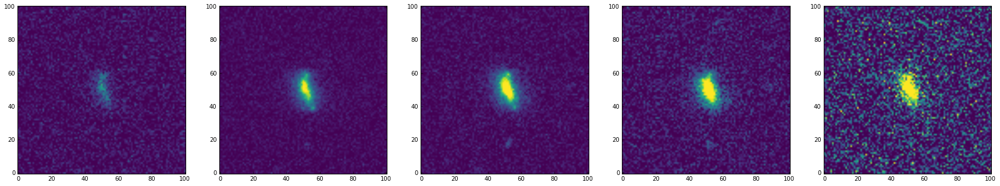

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


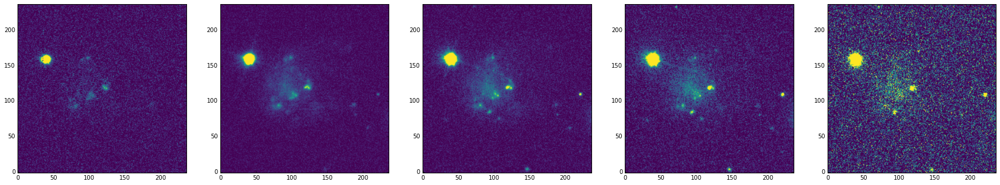

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


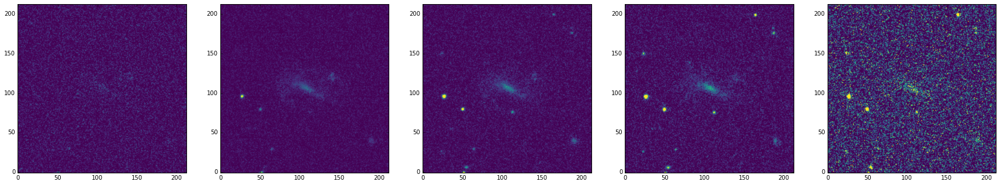

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


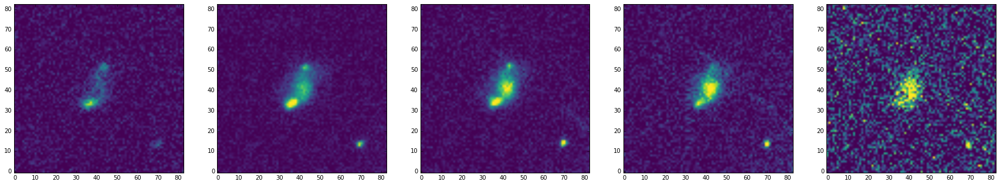

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


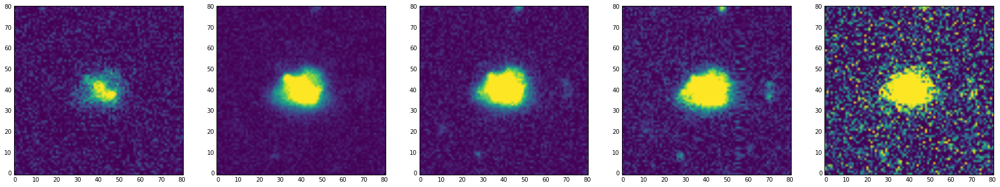

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


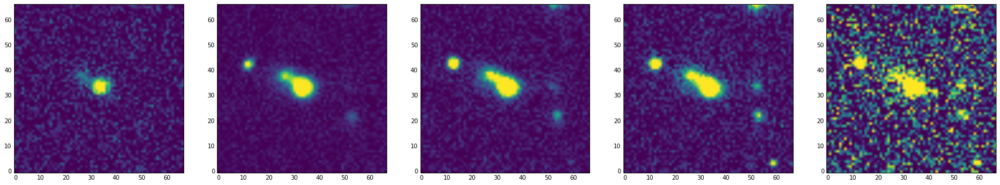

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


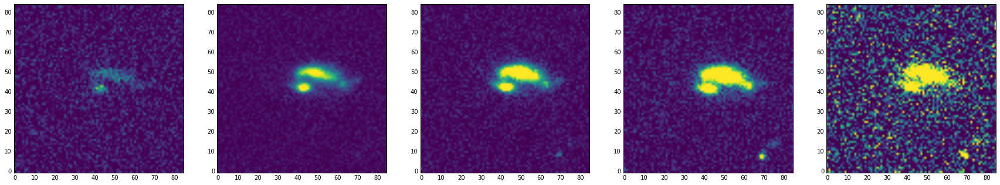

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


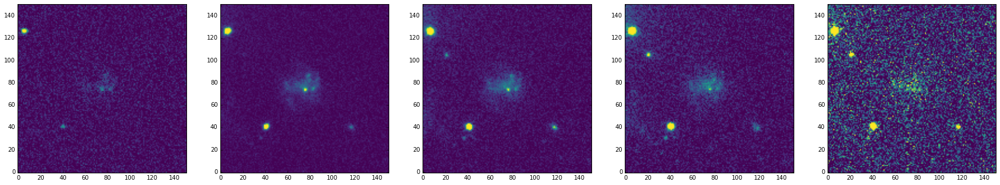

Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!


Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


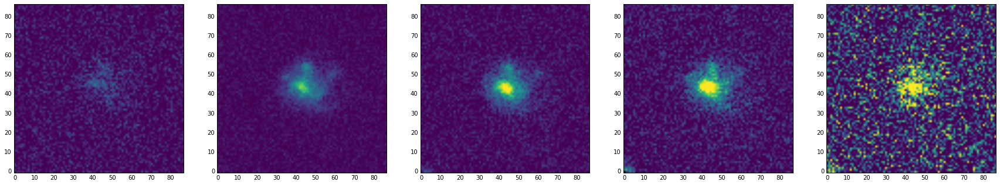

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


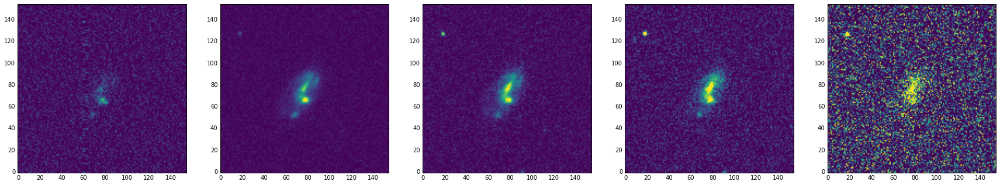

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


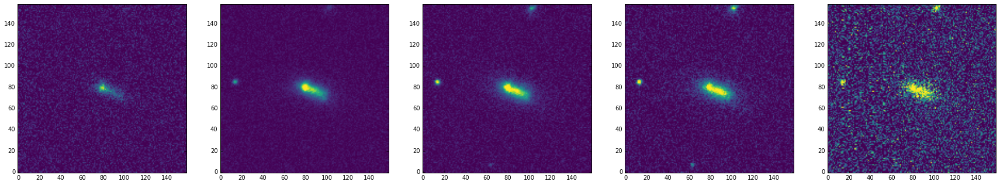

Cannot create subject stamp -- too close to image edge!
Successfully created subject stamp.
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Successfully created subject stamp.


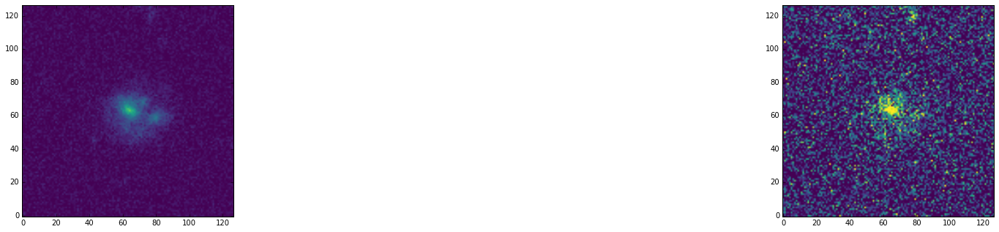

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


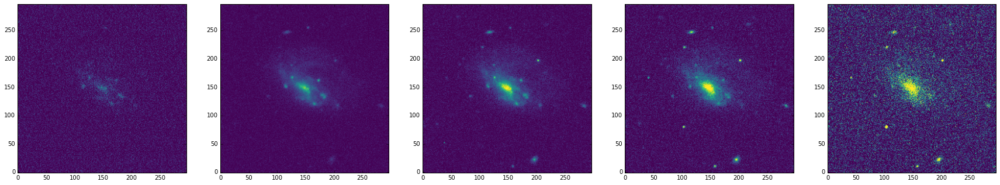

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


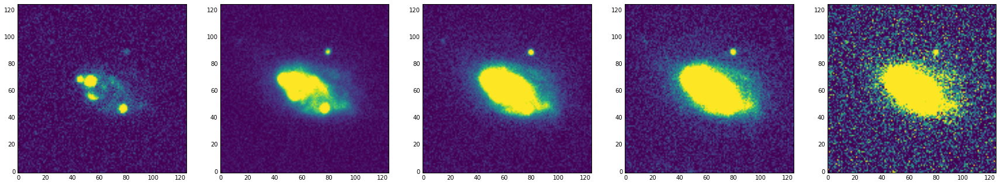

Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!
Cannot create subject stamp -- too close to image edge!


Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


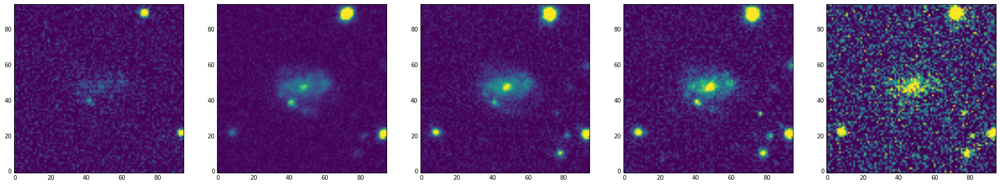

Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.
Successfully created subject stamp.


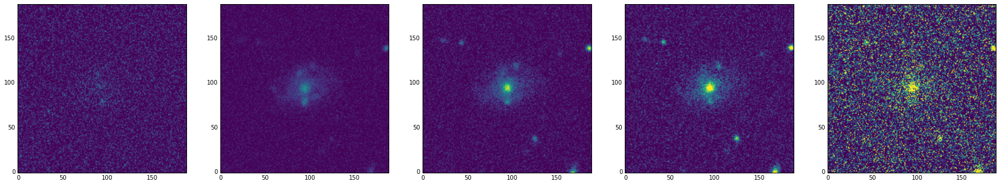

In [182]:
write_file = True

for gal in data[:20]:

    f = plt.figure(figsize=(30,100))
    gs = gridspec.GridSpec(1,5)
    
    for i, band in enumerate(['u','g','r','i','z']):
        filename = make_FITS_filename(gal['run'], gal['DR12_camcol'], gal['DR12_field'], band)
        decompressed = bz2.BZ2File("data/imaging_final45/{}".format(filename))
        hdulist = fits.open(decompressed)
    
        cutout = makecutout(hdulist, gal['ra'], gal['dec'], gal_size=gal['PETROR90_R'],
                            pixel_scale=0.396)
        try:
            cutout.writeto('data/final75_cutouts/'+filename.replace('.fits.bz2', '_stamp.fits'))
        except:
            pass
            
        if cutout:
            ax = plt.subplot(gs[0,i])
            ax.imshow(cutout.data,origin='lower',cmap='viridis',vmin=-0.01, vmax=.5)
    plt.show()

In [185]:
data['run','DR12_field'][:20]

run,DR12_field
int64,int64
3427,50
7778,234
4263,116
3360,437
3388,450
4263,272
2583,192
2585,63
1755,325
